#Text summarization using seq2seq Model

##1.Importing Dataset

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('20190928-reviews.csv')
df.head()

,asin,name,rating,date,verified,title,body,helpfulVotes
0,B0000SX2UC,Janet,3,"October 11, 2005",False,"Def not best, but not worst",I had the Samsung A600 for awhile which is abs...,1.0
1,B0000SX2UC,Luke Wyatt,1,"January 7, 2004",False,Text Messaging Doesn't Work,Due to a software issue between Nokia and Spri...,17.0
2,B0000SX2UC,Brooke,5,"December 30, 2003",False,Love This Phone,"This is a great, reliable phone. I also purcha...",5.0
3,B0000SX2UC,amy m. teague,3,"March 18, 2004",False,"Love the Phone, BUT...!","I love the phone and all, because I really did...",1.0
4,B0000SX2UC,tristazbimmer,4,"August 28, 2005",False,"Great phone service and options, lousy case!",The phone has been great for every purpose it ...,1.0


In [ ]:
data=pd.DataFrame()
data['title']=df['title']
data['body']=df['body']
data.head()

,title,body
0,"Def not best, but not worst",I had the Samsung A600 for awhile which is abs...
1,Text Messaging Doesn't Work,Due to a software issue between Nokia and Spri...
2,Love This Phone,"This is a great, reliable phone. I also purcha..."
3,"Love the Phone, BUT...!","I love the phone and all, because I really did..."
4,"Great phone service and options, lousy case!",The phone has been great for every purpose it ...


##2.Cleaning Data

In [ ]:
import re

# Remove non-alphabetic characters (Data Cleaning)
def text_strip(column):

    for row in column:
        row = re.sub("(\\t)", " ", str(row)).lower()
        row = re.sub("(\\r)", " ", str(row)).lower()
        row = re.sub("(\\n)", " ", str(row)).lower()

        # Remove _ if it occurs more than one time consecutively
        row = re.sub("(__+)", " ", str(row)).lower()

        # Remove - if it occurs more than one time consecutively
        row = re.sub("(--+)", " ", str(row)).lower()

        # Remove ~ if it occurs more than one time consecutively
        row = re.sub("(~~+)", " ", str(row)).lower()

        # Remove + if it occurs more than one time consecutively
        row = re.sub("(\+\++)", " ", str(row)).lower()

        # Remove . if it occurs more than one time consecutively
        row = re.sub("(\.\.+)", " ", str(row)).lower()

        # Remove the characters - <>()|&©ø"',;?~*!
        row = re.sub(r"[<>()|&©ø\[\]\'\",;?~*!]", " ", str(row)).lower()

        # Remove mailto:
        row = re.sub("(mailto:)", " ", str(row)).lower()

        # Remove \x9* in text
        row = re.sub(r"(\\x9\d)", " ", str(row)).lower()

        # Replace INC nums to INC_NUM
        row = re.sub("([iI][nN][cC]\d+)", "INC_NUM", str(row)).lower()

        # Replace CM# and CHG# to CM_NUM
        row = re.sub("([cC][mM]\d+)|([cC][hH][gG]\d+)", "CM_NUM", str(row)).lower()

        # Remove punctuations at the end of a word
        row = re.sub("(\.\s+)", " ", str(row)).lower()
        row = re.sub("(\-\s+)", " ", str(row)).lower()
        row = re.sub("(\:\s+)", " ", str(row)).lower()

        # Replace any url to only the domain name
        try:
            url = re.search(r"((https*:\/*)([^\/\s]+))(.[^\s]+)", str(row))
            repl_url = url.group(3)
            row = re.sub(r"((https*:\/*)([^\/\s]+))(.[^\s]+)", repl_url, str(row))
        except:
            pass

        # Remove multiple spaces
        row = re.sub("(\s+)", " ", str(row)).lower()

        # Remove the single character hanging between any two spaces
        row = re.sub("(\s+.\s+)", " ", str(row)).lower()

        yield row

In [ ]:
processed_title = text_strip(data['title'])
processed_body = text_strip(data['body'])

In [ ]:
import spacy
from time import time

nlp = spacy.load('en', disable=['ner', 'parser']) 

# Process text as batches and yield Doc objects in order
body = [str(doc) for doc in nlp.pipe(processed_body, batch_size=5000)]

title = ['_START_ '+ str(doc) + ' _END_' for doc in nlp.pipe(processed_title, batch_size=5000)]

In [ ]:
body[0]

'i had the samsung a600 for awhile which is absolute doo doo you can read my review on it and detect my rage at the stupid thing it finally died on me so used this nokia phone bought in garage sale for $1 wonder she sold it so cheap bad === hate the menu it takes forever to get to what you want because you have to scroll endlessly usually phones have numbered categories so can simply press the and get where you want to go === it a pain to put it on silent or vibrate if you re in class and it rings you have to turn it off immediately there no fast way to silence the damn thing always remember to put it on silent learned that the hard way === it so true about the case it a mission to get off and will break ur nails in the process also you ll damage the case each time try for some reason the phone started giving me problems once did succeed in opening it === buttons could be bit bigger vibration could be stronger good === reception is not too shabby was using it in the elevator which is r

In [ ]:
title[0]

'_START_ def not best but not worst _END_'

##3.Max permissible sequence length

In [ ]:
data['cleaned_body'] = pd.Series(body)
data['cleaned_title'] = pd.Series(title)

In [ ]:
data.head()

,title,body,cleaned_body,cleaned_title
0,"Def not best, but not worst",I had the Samsung A600 for awhile which is abs...,i had the samsung a600 for awhile which is abs...,_START_ def not best but not worst _END_
1,Text Messaging Doesn't Work,Due to a software issue between Nokia and Spri...,due to software issue between nokia and sprint...,_START_ text messaging doesn work _END_
2,Love This Phone,"This is a great, reliable phone. I also purcha...",this is great reliable phone also purchased th...,_START_ love this phone _END_
3,"Love the Phone, BUT...!","I love the phone and all, because I really did...",i love the phone and all because really did ne...,_START_ love the phone but _END_
4,"Great phone service and options, lousy case!",The phone has been great for every purpose it ...,the phone has been great for every purpose it ...,_START_ great phone service and options lousy ...


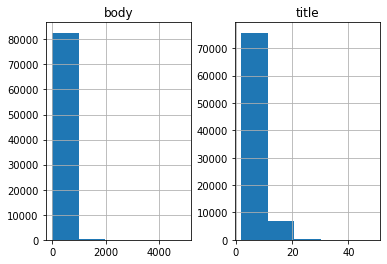

In [ ]:
import matplotlib.pyplot as plt

body_count = []
title_count = []

for sent in data['cleaned_body']:
    body_count.append(len(sent.split()))
    
for sent in data['cleaned_title']:
    title_count.append(len(sent.split()))

graph_df = pd.DataFrame() 

graph_df['body'] = body_count
graph_df['title'] = title_count

graph_df.hist(bins = 5)
plt.show()

In [ ]:
# Check how much % of text have 0-100 words
cnt = 0
for i in data['cleaned_body']:
    if len(i.split()) <= 200:
        cnt = cnt + 1
print(cnt / len(data['cleaned_body']))

0.960321197850631


In [ ]:
max_body_len = 200

In [ ]:
# Check how much % of text have 0-100 words
cnt = 0
for i in data['cleaned_title']:
    if len(i.split()) <= 20:
        cnt = cnt + 1
print(cnt / len(data['cleaned_title']))

0.9959186137776973


In [ ]:
max_title_len=20

##4.select plausible bodies and titles

In [ ]:
# Select the Summaries and Text which fall below max length 

import numpy as np

cleaned_body = np.array(data['cleaned_body'])
cleaned_title= np.array(data['cleaned_title'])

short_body = []
short_title = []

for i in range(len(cleaned_body)):
    if len(cleaned_title[i].split()) <= max_title_len and len(cleaned_body[i].split()) <= max_body_len:
        short_body.append(cleaned_body[i])
        short_title.append(cleaned_title[i])
        
post_pre = pd.DataFrame({'body': short_body,'title': short_title})

post_pre.head()

,body,title
0,due to software issue between nokia and sprint...,_START_ text messaging doesn work _END_
1,this is great reliable phone also purchased th...,_START_ love this phone _END_
2,i love the phone and all because really did ne...,_START_ love the phone but _END_
3,the phone has been great for every purpose it ...,_START_ great phone service and options lousy ...
4,hello have this phone and used it until decide...,_START_ worked great for me _END_


In [ ]:
# Add sostok and eostok

post_pre['title'] = post_pre['title'].apply(lambda x: 'sostok ' + x \
        + ' eostok')

post_pre.head()

,body,title
0,due to software issue between nokia and sprint...,sostok _START_ text messaging doesn work _END_...
1,this is great reliable phone also purchased th...,sostok _START_ love this phone _END_ eostok
2,i love the phone and all because really did ne...,sostok _START_ love the phone but _END_ eostok
3,the phone has been great for every purpose it ...,sostok _START_ great phone service and options...
4,hello have this phone and used it until decide...,sostok _START_ worked great for me _END_ eostok


##5.Tokenizing the text

In [ ]:
from sklearn.model_selection import train_test_split

x_tr, x_val, y_tr, y_val = train_test_split(
    np.array(post_pre["body"]),
    np.array(post_pre["title"]),
    test_size=0.1,
    random_state=0,
    shuffle=True,
)

In [ ]:
# Tokenize the text to get the vocab count 
from tensorflow.keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Prepare a tokenizer on training data
x_tokenizer = Tokenizer() 
x_tokenizer.fit_on_texts(list(x_tr))

In [ ]:
thresh = 5

cnt = 0
tot_cnt = 0

for key, value in x_tokenizer.word_counts.items():
    tot_cnt = tot_cnt + 1
    if value < thresh:
        cnt = cnt + 1
    
print("% of rare words in vocabulary: ", (cnt / tot_cnt) * 100)

% of rare words in vocabulary:  69.59292405195528


In [ ]:
# Prepare a tokenizer, again -- by not considering the rare words
x_tokenizer = Tokenizer(num_words = tot_cnt - cnt) 
x_tokenizer.fit_on_texts(list(x_tr))

# Convert text sequences to integer sequences 
x_tr_seq = x_tokenizer.texts_to_sequences(x_tr) 
x_val_seq = x_tokenizer.texts_to_sequences(x_val)

# Pad zero upto maximum length
x_tr = pad_sequences(x_tr_seq,  maxlen=max_body_len, padding='post')
x_val = pad_sequences(x_val_seq, maxlen=max_body_len, padding='post')

# Size of vocabulary (+1 for padding token)
x_voc = x_tokenizer.num_words + 1

print("Size of vocabulary in body = {}".format(x_voc))

Size of vocabulary in body = 8733


In [ ]:
# Prepare a tokenizer on training data
y_tokenizer = Tokenizer() 
y_tokenizer.fit_on_texts(list(y_tr))

In [ ]:
thresh = 5

cnt = 0
tot_cnt = 0

for key, value in y_tokenizer.word_counts.items():
    tot_cnt = tot_cnt + 1
    if value < thresh:
        cnt = cnt + 1
    
print("% of rare words in vocabulary: ", (cnt / tot_cnt) * 100)

% of rare words in vocabulary:  72.97546012269939


In [ ]:
# Prepare a tokenizer, again -- by not considering the rare words
y_tokenizer = Tokenizer(num_words = tot_cnt - cnt) 
y_tokenizer.fit_on_texts(list(y_tr))

# Convert text sequences to integer sequences 
y_tr_seq = y_tokenizer.texts_to_sequences(y_tr) 
y_val_seq = y_tokenizer.texts_to_sequences(y_val)

# Pad zero upto maximum length
y_tr = pad_sequences(y_tr_seq,  maxlen=max_title_len, padding='post')
y_val = pad_sequences(y_val_seq, maxlen=max_title_len, padding='post')

# Size of vocabulary (+1 for padding token)
y_voc = y_tokenizer.num_words + 1

print("Size of vocabulary in title = {}".format(y_voc))

Size of vocabulary in title = 2644


##6.removing empty data

In [ ]:
# Remove empty Summaries, .i.e, which only have 'START' and 'END' tokens
ind = []

for i in range(len(y_tr)):
    cnt = 0
    for j in y_tr[i]:
        if j != 0:
            cnt = cnt + 1
    if cnt == 2:
        ind.append(i)

y_tr = np.delete(y_tr, ind, axis=0)
x_tr = np.delete(x_tr, ind, axis=0)

In [ ]:
x_tr

array([[ 100,   21,  891, ...,    0,    0,    0],
       [ 800,  263,  295, ...,    0,    0,    0],
       [  43,    1,  530, ...,    0,    0,    0],
       ...,
       [  11,  460,    9, ...,    0,    0,    0],
       [   7,   80,    6, ...,    0,    0,    0],
       [5013, 6952,  872, ...,    0,    0,    0]], dtype=int32)

In [ ]:
y_tr

array([[   3,    2,   35, ...,    0,    0,    0],
       [   3,    2,   34, ...,    0,    0,    0],
       [   3,    2,    7, ...,    0,    0,    0],
       ...,
       [   3,    2,    7, ...,    0,    0,    0],
       [   3,    2,  231, ...,    0,    0,    0],
       [   3,    2, 2143, ...,    0,    0,    0]], dtype=int32)

In [ ]:
# Remove empty Summaries, .i.e, which only have 'START' and 'END' tokens
ind = []
for i in range(len(y_val)):
    cnt = 0
    for j in y_val[i]:
        if j != 0:
            cnt = cnt + 1
    if cnt == 2:
        ind.append(i)

y_val = np.delete(y_val, ind, axis=0)
x_val = np.delete(x_val, ind, axis=0)

In [ ]:
y_val

array([[ 3,  2, 43, ...,  0,  0,  0],
       [ 3,  2,  9, ...,  0,  0,  0],
       [ 3,  2, 20, ...,  0,  0,  0],
       ...,
       [ 3,  2, 42, ...,  0,  0,  0],
       [ 3,  2, 50, ...,  0,  0,  0],
       [ 3,  2, 51, ...,  0,  0,  0]], dtype=int32)

In [ ]:
x_val

array([[ 11, 460,  43, ...,   0,   0,   0],
       [ 26, 343,  10, ...,   0,   0,   0],
       [ 27,  63, 103, ...,   0,   0,   0],
       ...,
       [  7,   9,  22, ...,   0,   0,   0],
       [ 97,  16,  47, ...,   0,   0,   0],
       [ 27, 332,  43, ...,   0,   0,   0]], dtype=int32)

##7.Creating the model

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Input, LSTM, Embedding, Dense, Concatenate, TimeDistributed
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping

In [ ]:
latent_dim = 300
embedding_dim = 200

# Encoder
encoder_inputs = Input(shape=(max_body_len, ))

# Embedding layer
enc_emb = Embedding(x_voc, embedding_dim,
                    trainable=True)(encoder_inputs)

# Encoder LSTM 1
encoder_lstm1 = LSTM(latent_dim, return_sequences=True,
                     return_state=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_output1, state_h1, state_c1) = encoder_lstm1(enc_emb)

# Encoder LSTM 2
encoder_lstm2 = LSTM(latent_dim, return_sequences=True,
                     return_state=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_output2, state_h2, state_c2) = encoder_lstm2(encoder_output1)

# Encoder LSTM 3
encoder_lstm3 = LSTM(latent_dim, return_state=True,
                     return_sequences=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_outputs, state_h, state_c) = encoder_lstm3(encoder_output2)

# Set up the decoder, using encoder_states as the initial state
decoder_inputs = Input(shape=(None, ))

# Embedding layer
dec_emb_layer = Embedding(y_voc, embedding_dim, trainable=True)
dec_emb = dec_emb_layer(decoder_inputs)

# Decoder LSTM
decoder_lstm = LSTM(latent_dim, return_sequences=True,
                    return_state=True, dropout=0.4,
                    recurrent_dropout=0.2)
(decoder_outputs, decoder_fwd_state, decoder_back_state) = \
    decoder_lstm(dec_emb, initial_state=[state_h, state_c])

# Dense layer
decoder_dense = TimeDistributed(Dense(y_voc, activation='softmax'))
decoder_outputs = decoder_dense(decoder_outputs)

# Define the model
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 200)]        0           []                               
                                                                                                  
 embedding (Embedding)          (None, 200, 200)     1746600     ['input_1[0][0]']                
                                                                                                  
 lstm (LSTM)                    [(None, 200, 300),   601200      ['embedding[0][0]']              
                                 (None, 300),                                                     
                                 (None, 300)]                                                     
                                                                                              

##8.Training the model

In [ ]:
model.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy')

es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=2)

In [ ]:
history = model.fit(
    [x_tr, y_tr[:, :-1]],
    y_tr.reshape(y_tr.shape[0], y_tr.shape[1], 1)[:, 1:],
    epochs=1,
    callbacks=[es],
    batch_size=220,
    validation_data=([x_val, y_val[:, :-1]],
                     y_val.reshape(y_val.shape[0], y_val.shape[1], 1)[:
                     , 1:]),
    )

325/325 [==============================] - 9532s 29s/step - loss: 1.1835 - val_loss: 1.1135


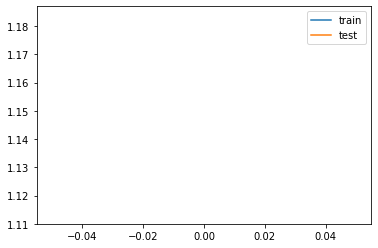

In [ ]:
from matplotlib import pyplot

pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

##9.Prediction

In [ ]:
reverse_target_word_index = y_tokenizer.index_word
reverse_source_word_index = x_tokenizer.index_word
target_word_index = y_tokenizer.word_index

In [ ]:
# Inference Models

# Encode the input sequence to get the feature vector
encoder_model = Model(inputs=encoder_inputs, outputs=[encoder_outputs,
                      state_h, state_c])

# Decoder setup

# Below tensors will hold the states of the previous time step
decoder_state_input_h = Input(shape=(latent_dim, ))
decoder_state_input_c = Input(shape=(latent_dim, ))
decoder_hidden_state_input = Input(shape=(max_body_len, latent_dim))

# Get the embeddings of the decoder sequence
dec_emb2 = dec_emb_layer(decoder_inputs)

# To predict the next word in the sequence, set the initial states to the states from the previous time step
(decoder_outputs2, state_h2, state_c2) = decoder_lstm(dec_emb2,
        initial_state=[decoder_state_input_h, decoder_state_input_c])

# A dense softmax layer to generate prob dist. over the target vocabulary
decoder_outputs2 = decoder_dense(decoder_outputs2)

# Final decoder model
decoder_model = Model([decoder_inputs] + [decoder_hidden_state_input,
                      decoder_state_input_h, decoder_state_input_c],
                      [decoder_outputs2] + [state_h2, state_c2])

In [ ]:
def decode_sequence(input_seq):

    # Encode the input as state vectors.
    (e_out, e_h, e_c) = encoder_model.predict(input_seq)

    # Generate empty target sequence of length 1
    target_seq = np.zeros((1, 1))

    # Populate the first word of target sequence with the start word.
    target_seq[0, 0] = target_word_index['sostok']

    stop_condition = False
    decoded_sentence = ''

    while not stop_condition:
        (output_tokens, h, c) = decoder_model.predict([target_seq]
                + [e_out, e_h, e_c])

        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_token = reverse_target_word_index[sampled_token_index]

        if sampled_token != 'eostok':
            decoded_sentence += ' ' + sampled_token

        # Exit condition: either hit max length or find the stop word.
        if sampled_token == 'eostok' or len(decoded_sentence.split()) \
            >= max_title_len - 1:
            stop_condition = True

        # Update the target sequence (of length 1)
        target_seq = np.zeros((1, 1))
        target_seq[0, 0] = sampled_token_index

        # Update internal states
        (e_h, e_c) = (h, c)

    return decoded_sentence

In [ ]:
# To convert sequence to summary
def seq2summary(input_seq):
    newString = ''
    for i in input_seq:
        if i != 0 and i != target_word_index['sostok'] and i \
            != target_word_index['eostok']:
            newString = newString + reverse_target_word_index[i] + ' '

    return newString


# To convert sequence to text
def seq2text(input_seq):
    newString = ''
    for i in input_seq:
        if i != 0:
            newString = newString + reverse_source_word_index[i] + ' '

    return newString

In [ ]:
for i in range(0, 19):
    print ('Review:', seq2text(x_tr[i]))
    print ('Original summary:', seq2summary(y_tr[i]))
    print ('Predicted summary:', decode_sequence(x_tr[i].reshape(1,max_body_len)))
    print ('****************************')

Review: working as promised no real cosmetic issues noted perhaps battery life is bit but still makes it through the day just fine 
Original summary: start as promised end 
Predicted summary:  start five stars end
****************************
Review: xperia us support is too bad to understand the problem over phone or chat this phone doesnt support wifi calling with tmobile 
Original summary: start no wifi calling with tmobile end 
Predicted summary:  start five stars end
****************************
Review: love the fact that knew what to expect phone is great fingerprint scanner isn the best even compared to samsung galaxy a70 and battery life is okay but the fun factor is there had it not been for the moto mods not sure whether d stick with motorola but the z4 definitely lives up to its name 
Original summary: start great device for those who have moto mods end 
Predicted summary:  start five stars end
****************************
Review: my samsung galaxy s4 arrived within day and 

#Summarization using Pegasus

Pegasus model is built using a transformer encoder-decoder

In [ ]:
df1 = pd.read_csv('20190928-reviews.csv')

In [ ]:
S=""
for i in df1['body']:
  S+=str(i)
S

'I had the Samsung A600 for awhile which is absolute doo doo. You can read my review on it and detect my rage at the stupid thing. It finally died on me so I used this Nokia phone I bought in a garage sale for $1. I wonder y she sold it so cheap?... Bad: ===> I hate the menu. It takes forever to get to what you want because you have to scroll endlessly. Usually phones have numbered categories so u can simply press the # and get where you want to go. ===> It\'s a pain to put it on silent or vibrate. If you\'re in class and it rings, you have to turn it off immediately. There\'s no fast way to silence the damn thing. Always remember to put it on silent! I learned that the hard way. ===> It\'s so true about the case. It\'s a mission to get off and will break ur nails in the process. Also, you\'ll damage the case each time u try. For some reason the phone started giving me problems once I did succeed in opening it. ===> Buttons could be a bit bigger. Vibration could be stronger. Good: ===>

##1.install depencies

In [ ]:
!pip install torch==1.8.2+cu111 torchvision==0.9.2+cu111 torchaudio===0.8.2 -f https://download.pytorch.org/whl/lts/1.8/torch_lts.html


Looking in links: https://download.pytorch.org/whl/lts/1.8/torch_lts.html
     |█████████████▌                  | 834.1 MB 1.6 MB/s eta 0:12:07tcmalloc: large alloc 1147494400 bytes == 0x559f00d14000 @  0x7f2d2c882615 0x559ec7f6a4cc 0x559ec804a47a 0x559ec7f6d2ed 0x559ec805ee1d 0x559ec7fe0e99 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fe0d00 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fdd737 0x559ec805fc66 0x559ec7fdcdaf 0x559ec805fc66 0x559ec7fdcdaf 0x559ec805fc66 0x559ec7fdcdaf 0x559ec7f6f039 0x559ec7fb2409 0x559ec7f6dc52 0x559ec7fe0c25 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fdd737 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fdc915 0x559ec7f6eafa 0x559ec7fdcc0d 0x559ec7fdb9ee
     |█████████████████               | 1055.7 MB 1.4 MB/s eta 0:10:59tcmalloc: large alloc 1434370048 bytes == 0x559f4536a000 @  0x7f2d2c882615 0x559ec7f6a4cc 0x559ec804a47a 0x559ec7f6d2ed 0x559ec805ee1d 0x559ec7fe0e99 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fe0d00 0x559ec7fdb9ee 0x559ec7f6ebda 0x559ec7fdd737 0x559ec805fc66 0x559ec

In [ ]:
pip install Sentencepiece


     |████████████████████████████████| 1.2 MB 4.1 MB/s 


In [ ]:
!pip install transformers


     |████████████████████████████████| 3.4 MB 4.2 MB/s 
     |████████████████████████████████| 895 kB 33.0 MB/s 
     |████████████████████████████████| 3.3 MB 26.1 MB/s 
     |████████████████████████████████| 61 kB 151 kB/s 
     |████████████████████████████████| 596 kB 13.6 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


##2.import and load model

In [ ]:
from transformers import PegasusForConditionalGeneration, PegasusTokenizer


In [ ]:
tokenizer = PegasusTokenizer.from_pretrained("google/pegasus-xsum")


Downloading:   0%|          | 0.00/1.82M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/65.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/87.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

In [ ]:
model = PegasusForConditionalGeneration.from_pretrained("google/pegasus-xsum")


Downloading:   0%|          | 0.00/2.12G [00:00<?, ?B/s]

##3.perform abstractive summarization

In [ ]:
tokens = tokenizer(S, truncation=True, padding="longest", return_tensors="pt")


In [ ]:
tokens

{'input_ids': tensor([[  125,   196,   109,  4122,   202,  9725,   118, 12741,   162,   117,
          4448,   171,   554,   171,   554,   107,   226,   137,   516,   161,
           933,   124,   126,   111,  6595,   161, 13936,   134,   109,  9049,
           474,   107,   168,  1477,  2342,   124,   213,   167,   125,   263,
           136, 11032,   685,   125,  2020,   115,   114,  2733,   925,   118,
          4053,   107,   125,  2686,  5209,   265,  1575,   126,   167,  2086,
           152,   401,  6843,   151,  3092, 92918,   125,  4180,   109,  1943,
           107,   168,   839,  3689,   112,   179,   112,   180,   119,   245,
           262,   119,   133,   112,  9029, 28210,   107,  8114,  3907,   133,
         16240,  3510,   167,  4911,   137,   705,  1833,   109,  1768,   111,
           179,   241,   119,   245,   112,   275,   107,  3092, 92918,   168,
           131,   116,   114,  1246,   112,   414,   126,   124,  7594,   132,
         39015,   107,   240,   119,  

In [ ]:
summary = model.generate(**tokens)


In [ ]:
summary[0]


tensor([  0, 168, 131, 116, 174, 114, 300, 166, 381, 125, 131, 261, 263, 114,
        685, 107,   1])

In [ ]:
tokenizer.decode(summary[0])


"It's been a long time since I've used a phone."